In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import seaborn as sns

import os


# 1. Loading the datasets


In [2]:
files = os.listdir(r'C:\Users\Admin\Desktop\Machine Learning\Udemy')[-7:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [3]:
files.remove('uber-raw-data-janjune-15.csv')


In [6]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

# Loading all the files from the path

In [11]:
path = r'C:\Users\Admin\Desktop\Machine Learning\Udemy'
final=pd.DataFrame()
for file in files:
    df=pd.read_csv(path+"/"+file,encoding='utf-8')
    final=pd.concat([final,df])

In [12]:
final.shape


(4534327, 4)

In [13]:
df=final.copy()

In [14]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


# Formating the date and time

In [15]:
df['Date/Time']=pd.to_datetime(df['Date/Time'],format='%m/%d/%Y  %H:%M:%S')


In [16]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [17]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


In [18]:
df['weekday']=df['Date/Time'].dt.day_name()


In [ ]:
df

In [19]:
df['day']=df['Date/Time'].dt.day


In [20]:
df

,Date/Time,Lat,Lon,Base,weekday,day
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1
...,...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,Tuesday,30
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,Tuesday,30
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,Tuesday,30
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,Tuesday,30


# Analysing the rush by day,month,hour and minute

In [21]:
df['month']=df['Date/Time'].dt.month
df['hour']=df['Date/Time'].dt.hour
df['minute']=df['Date/Time'].dt.minute

In [22]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


# Counting cabs booked on each day

In [23]:
df['weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: weekday, dtype: int64

In [24]:
!pip install plotly

# Plotting bar against cabs booked on each day

In [25]:
import plotly.express as px

In [26]:
px.bar(x=df['weekday'].value_counts().index,
      y=df['weekday'].value_counts())

# Plotting Histogram for Each Hour of the day

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

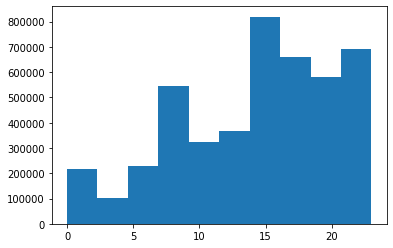

In [27]:
plt.hist(df['hour'])

In [28]:
df['month'].unique()

array([4, 8, 7, 6, 5, 9], dtype=int64)

# finding cabs booked in each month

In [29]:
for i,month in enumerate(df['month'].unique()):
    print(i)
    print(month)

0
4
1
8
2
7
3
6
4
5
5
9


#  Plots for Cabs booked in each month

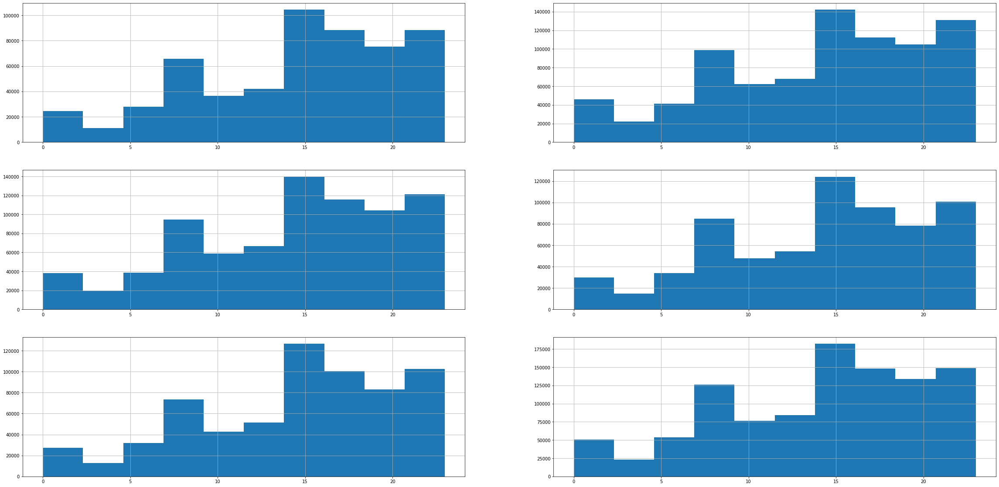

In [30]:
plt.figure(figsize=(40,20))

for i,month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    df[df['month']==month]['hour'].hist()

In [31]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


In [32]:

import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [33]:
!pip install chart_studio

In [34]:
import chart_studio.plotly as py

# Grouping my data as hour and month

In [35]:
df.groupby('month')['hour'].count()

month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: hour, dtype: int64

# Plotting data as month vs. hour

In [36]:
trace1 = go.Bar(x=df.groupby('month')['hour'].count().index,
      y=df.groupby('month')['hour'].count(),
      name='Priority')

In [37]:
iplot([trace1])

# Cross checking my analytics using seaborn

c:\users\admin\appdata\local\programs\python\python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='day', ylabel='Density'>

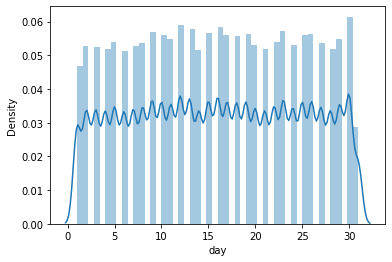

In [38]:
sns.distplot(df['day'])

Text(0.5, 1.0, 'Journeys per day')

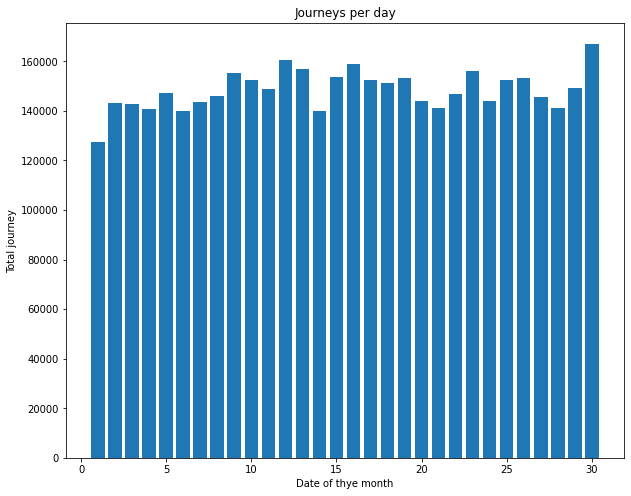

In [39]:
plt.figure(figsize=(10,8))
plt.hist(df['day'],bins=30,rwidth=0.8,range=(0.5,30.5))
plt.xlabel('Date of thye month')
plt.ylabel('Total journey')
plt.title('Journeys per day')


# Plotting for the data as month vs. day

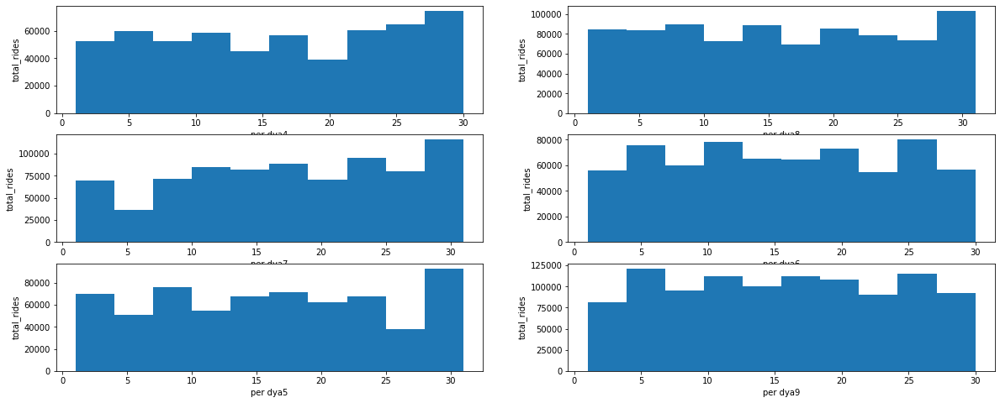

In [40]:
plt.figure(figsize=(20,8))
for i,month in enumerate(df['month'].unique(),1):
    plt.subplot(3,2,i)
    df_out=df[df['month']==month]
    plt.hist(df_out['day'])
    plt.xlabel('per day{}'.format(month))
    plt.ylabel('total_rides')

# Plotting data for hours of day vs. lattitude of passenger

Text(0.5, 1.0, 'hours of day vs. latitude of passenger')

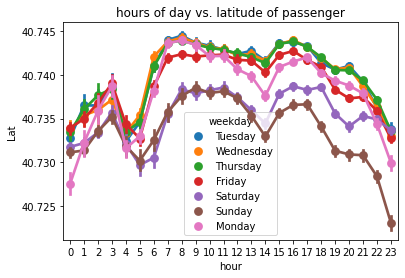

In [41]:
ax=sns.pointplot(x='hour',y='Lat',data=df,hue='weekday')
ax.set_title('hours of day vs. latitude of passenger')

In [42]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


In [43]:
base=df.groupby(['Base','month'])['Date/Time'].count().reset_index()
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


# Plotting data as date&time vs. month

<AxesSubplot:xlabel='month', ylabel='Date/Time'>

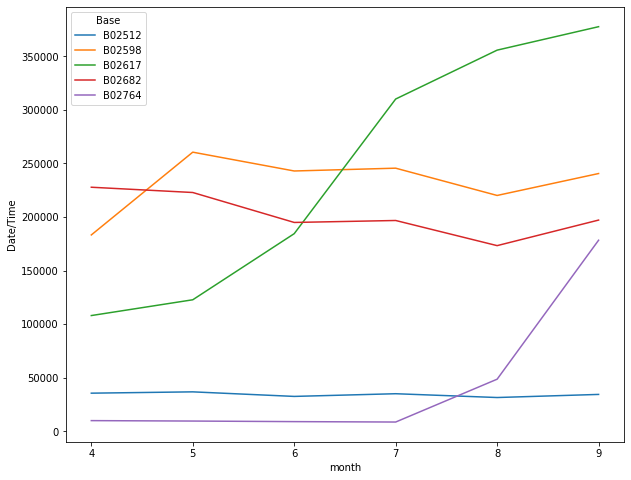

In [44]:
plt.figure(figsize=(10,8))
sns.lineplot(x='month',y='Date/Time', hue='Base',data=base)


# Creating function to count rush at hours on weekdays

In [45]:
def count_row(rows):
    return len(rows)

In [46]:
by_cross=df.groupby(['weekday','hour']).apply(count_row)
by_cross

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [47]:
pivot=by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


# Plotting heatmap as hour vs. weekday

<AxesSubplot:xlabel='hour', ylabel='weekday'>

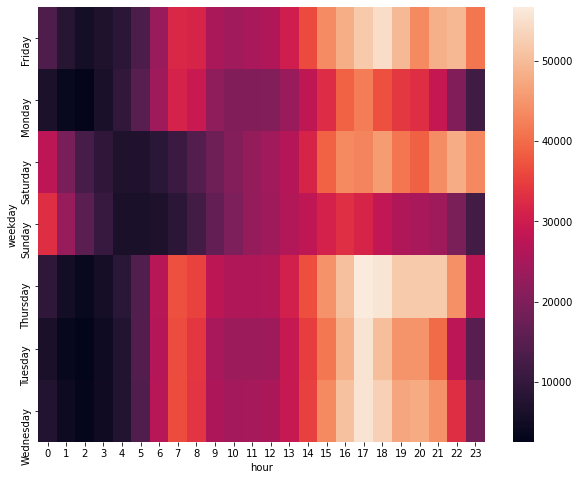

In [48]:
plt.figure(figsize=(10,8))
sns.heatmap(pivot)

# Crerating a function which will analyze the data by any factors

In [49]:
def heatmap(col1,col2):
    by_cross=df.groupby([col1,col2]).apply(count_row)
    pivot=by_cross.unstack()
    plt.figure(figsize=(10,8))
    return sns.heatmap(pivot)

<AxesSubplot:xlabel='hour', ylabel='day'>

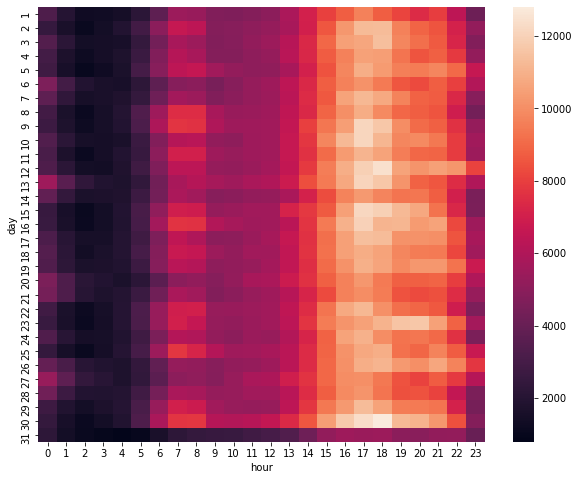

In [50]:
heatmap('day','hour')

<AxesSubplot:xlabel='month', ylabel='day'>

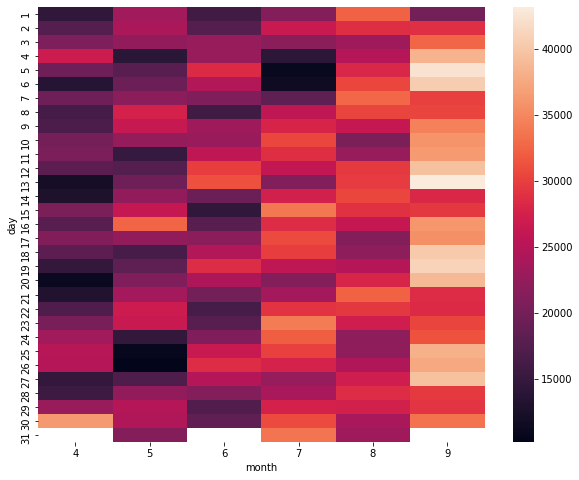

In [51]:
heatmap('day','month')

<AxesSubplot:xlabel='month', ylabel='weekday'>

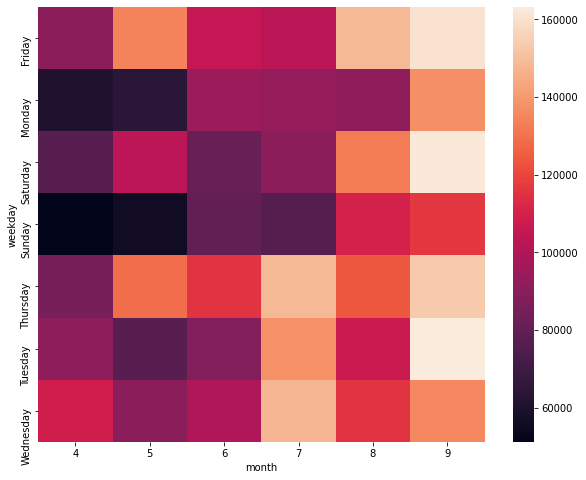

In [52]:
heatmap('weekday','month')

In [53]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


# Plotting data as longitude vs. lattitude

(40.6, 41.0)

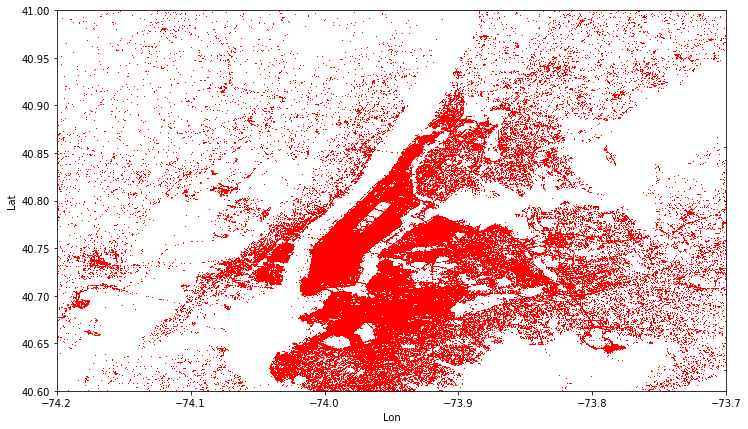

In [54]:
plt.figure(figsize=(12,7))
plt.plot(df['Lon'],df['Lat'], 'r+',ms=0.5)
plt.xlabel('Lon')
plt.ylabel('Lat')
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

In [55]:
df_out=df[df['weekday']=='Sunday']


In [56]:
df_out.shape

(490180, 9)

In [57]:
rush=df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()
rush

,Lat,Lon,weekday
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [58]:
rush.columns=['Lon','Lat','No of trips']
rush.head()

,Lon,Lat,No of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1


In [59]:
!pip install folium

In [60]:
from folium.plugins import HeatMap
import folium

# creating a real map

In [61]:
basemap=folium.Map()

In [62]:
HeatMap(rush,zoom=20,radius=15).add_to(basemap)
basemap 

# Creating a function which will analyze the rush on any day as latitude vs. longitude

In [63]:
def plot(df,day):
    basemap=folium.Map()
    df_out=df[df['weekday']==day]
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [64]:
plot(df,'Tuesday')

# Analysing the another dataset

In [65]:
uber15=pd.read_csv(r'C:\Users\Admin\Desktop\Machine Learning\Udemy\uber-raw-data-janjune-15.csv')

In [66]:
uber15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [67]:
uber15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [68]:
uber15['Pickup_date']=pd.to_datetime(uber15['Pickup_date'],format='%Y-%m-%d  %H:%M:%S')

In [69]:
uber15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [70]:
uber15['weekday']=uber15['Pickup_date'].dt.day_name()
uber15['day']=uber15['Pickup_date'].dt.day
uber15['minute']=uber15['Pickup_date'].dt.minute
uber15['month']=uber15['Pickup_date'].dt.month
uber15['hour']=uber15['Pickup_date'].dt.hour

In [71]:
uber15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,minute,month,hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,5,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,5,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,5,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,5,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,5,9


# Analysing the rush in each month

In [74]:
px.bar(x=uber15['month'].value_counts().index,
       y=uber15['month'].value_counts()
      )

# Analysing the rush in hour

c:\users\admin\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='hour', ylabel='count'>

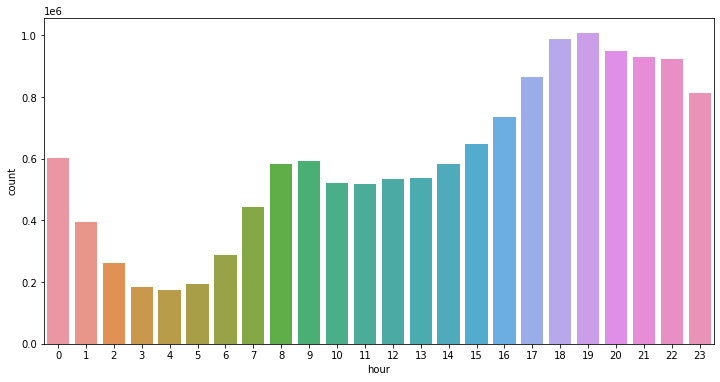

In [75]:

plt.figure(figsize=(12,6))
sns.countplot(uber15['hour'])

In [77]:
summary=uber15.groupby(['weekday','hour'])['Pickup_date'].count().reset_index()
summary.head()

,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


In [78]:
summary.columns=['weekday','hour','counts']

In [79]:
summary.head()

,weekday,hour,counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


# Plotting the data as hour vs. total pickups

<AxesSubplot:xlabel='hour', ylabel='counts'>

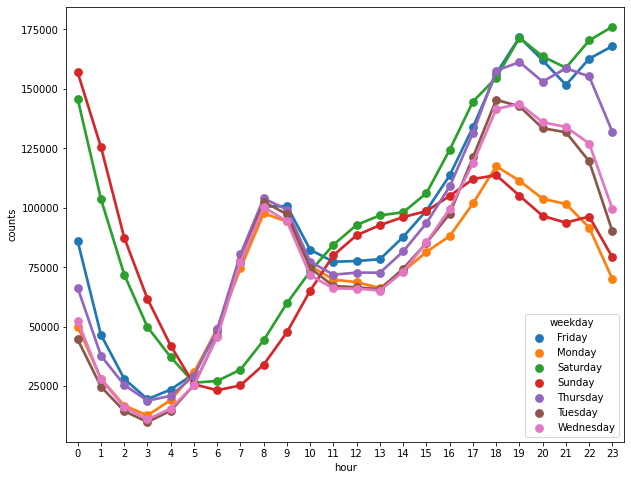

In [81]:
plt.figure(figsize=(10,8))
sns.pointplot(x='hour',y='counts',hue='weekday',data=summary)

# Analysing another data

In [82]:
uberfoil=pd.read_csv(r'C:\Users\Admin\Desktop\Machine Learning\Udemy\Uber-Jan-Feb-FOIL.csv')

In [83]:
uberfoil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [84]:
uberfoil.shape

(354, 4)

In [85]:
uberfoil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

# Plotting box bar

<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

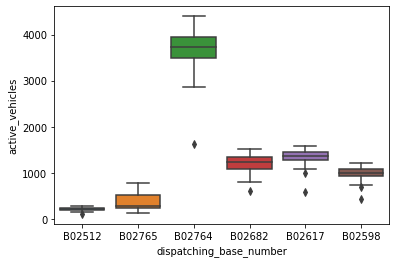

In [86]:
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uberfoil)

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

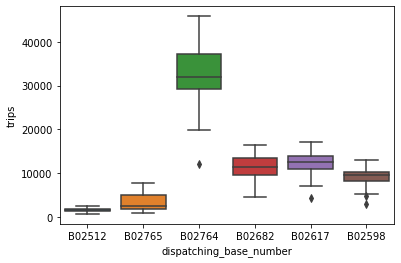

In [87]:
sns.boxplot(x='dispatching_base_number',y='trips',data=uberfoil)

In [89]:
uberfoil['trips/vehicle']=uberfoil['trips']/uberfoil['active_vehicles']

In [90]:
uberfoil.head(5)

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


# Plotting graph for Demand vs Supply

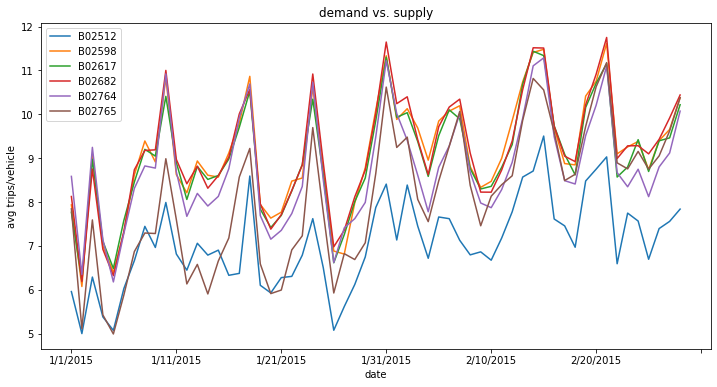

In [93]:
plt.figure(figsize=(12,6))
uberfoil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('avg trips/vehicle')
plt.title('demand vs. supply')
plt.legend()